# Tutorial on the RUS equations (Rayleigh-Ritz method in code)

Show the tools in that RUS toolbox through a worked example.  This notebook is for learning purposes, therefore you will see lots of visualizations just to take you by the hand across the algorithm.

# Example: Cylinder of Copper (elastic values for copper from De Rue (1996))

I adapted the codes of the [PALab](https://github.com/PALab) for [RUS](https://github.com/PALab/RUS) to reproduce the results. These codes were provided by Zadler et al. (2004) and translated to Python by [Paul Freeman](https://github.com/paul-freeman) in 2015. The functions needed are in the file `rus_tools.py`.  The formula for the spheroid in Zadler et al. (2004) has a typo on the multiplying factor (it should be $\pi/2$ instead of $4\pi$!).

The eigenvalues are related to the resonant frequencies of the object!!!

> **Remember to shutdown the kernel and restarting it to clear the memoization global variables before a new run!!!**

The cell below is an example of a typical forward model: given the elastic parameters and shape of an object, calculate its normal mode frequencies and, if needed, the displacements at a given location on or within it.

In [1]:
# Download a data file from github, if it doesn't exist
!test ! -f rus_tools.py && wget 'https://raw.githubusercontent.com/edur409/Circumferential-Surface-Waves/main/RUS/rus_tools.py'

In [2]:
%%time
import sys
import scipy
import numpy
import scipy.linalg.lapack as lapack
import scipy.linalg as la
from math import sqrt
import rus_tools as rus

def c_l(lam, mu, rho):
    return 1000*numpy.sqrt((lam + 2*mu)/rho)

def c_t(mu, rho):
    return 1000*numpy.sqrt(mu/rho)

# Inputs
# Aluminium: Lam: 53.0989  , Mu: 26.0 , Rho: 2.710
# Copper: Lam: 105.6 GPa, Mu: 48.3 GPa, Rho: 8.933 g/cm^3
Lam = 105.6 # GPa 53.0989#
Mu = 48.3 # GPa 26.7195
rho = 8.933 # cm^3 2.710 #

print('Vp: ', c_l(Lam, Mu, rho))
print('Vs: ', c_t(Mu, rho))

# Shape of object and dimensions
shape = 1 # 1 for cylinder.  2 for a sphere
args = {'nfreq': 16, 'outeigen': None}
a = {'c11': Lam + 2*Mu, 'c44': Mu}
dimension1 = 4.422/2 #150.0 # Radius 1 4.422/2 #
dimension2 = 4.422/2 #150.0 # Radius 2 4.422/2 #
dimension3 = 2.5 # Radius 3  # Use this: 150.0e4 and cylinder shape = 1 for infinite cylinder #6.414/2 #
dimensions = [dimension1, dimension2, dimension3]

# Elastic matrix and stiffness tensor
cm = rus.make_cm(a, hextype=None) # Voigt notation 6X6 array
cijkl = rus.stiffness(cm) # Full tensor 3x3x3x3 array
# print('DATA C/ ',cijkl.reshape(81, order='F')) # Vissher et al. (1991) Fortran code for Cijkl

# Code starts
d = 8 # N order or NN in Vissher et al. 1991
problem_size = int(3*(d + 1)*(d + 2)*(d + 3)/6) # R in Vissher et al. 1991

tabs, irk = rus.index_relationship(d, problem_size)

e = rus.e_fill(tabs, dimensions, rho, shape, irk)

gamma = rus.gamma_fill(tabs, dimensions, cm, shape, irk)

print("done preparing matrices") # It works find until here

jobz = 'N'
if args['outeigen'] == None: #args.outeigen == None:
    jobz = 'N'
else:
    jobz = 'V'

# Solves the eigenproblem for each block of the block-diagonal matrix Gamma
# Each matrix in the block is positive-difinite
w = []
eigvals = []
eigvect = []
for k in range(8):
    # lapack routine
    #w_temp, _, _ = lapack.dsygv(gamma[k], e[k], itype=1, jobz=jobz, uplo='U')
    w_temp, v_temp = la.eigh(gamma[k], e[k], lower=False, eigvals_only=False, type=1, overwrite_a=True, overwrite_b=True, check_finite=False)
    w.append(w_temp)
    eigvals.append(w_temp)
    eigvect.append(numpy.transpose(v_temp)) # Transpose if needed!

# start eigen vectors (block)
r = problem_size
z = numpy.zeros((r,r)) # Matrix of eigenvectors matching tabs array
irf = 0
for k in range(8):
    for ir1 in range(irf,irf+irk[k]):
        for ir2 in range(irf,irf+irk[k]):
            z[ir2][ir1] = eigvect[k][ir2-irf][ir1-irf]
    for ir1 in range(irk[k]+irf,r):
        for ir2 in range(irf,irf+irk[k]):
            z[ir2][ir1] = 0.0
    irf += irk[k]
# end eigen vectors (block)

# Sort eigenvalues
wsort = numpy.zeros(problem_size)
i = 0
for k in range(8):
    for ir1 in range(irk[k]):
        wsort[i] = w[k][ir1]
        i += 1
wsort.sort()

# Choose the unique values inside the eigenvalue array
eigenfreqs = numpy.unique(numpy.round(1e5*numpy.sqrt(wsort[6:])/(2.0*numpy.pi), decimals=4))

i = 0
ir1 = 0
while ir1 < args['nfreq']:#args.nfreq:
    ir1 += 1
    print(" f%d = %f" % (ir1, eigenfreqs[i]))
    i += 1


Vp:  4757.64363463834
Vs:  2325.2780841414174
irk[0]=75
irk[1]=50
irk[2]=50
irk[3]=60
irk[4]=60
irk[5]=75
irk[6]=75
irk[7]=50
done preparing matrices
 f1 = 23252.780800
 f2 = 29025.261200
 f3 = 33912.587100
 f4 = 34102.443000
 f5 = 35398.356800
 f6 = 38744.423100
 f7 = 39924.945200
 f8 = 46506.339100
 f9 = 46650.930400
 f10 = 50019.758500
 f11 = 50106.715000
 f12 = 51244.198000
 f13 = 51602.087000
 f14 = 54032.370700
 f15 = 54181.931900
 f16 = 55174.008600
CPU times: user 1.48 s, sys: 17.1 ms, total: 1.5 s
Wall time: 2.1 s


## The sorted eigenvalues

notice the repetitions of eigenvalues.

In [3]:
numpy.round(1e5*numpy.sqrt(wsort[6:])/(2.0*numpy.pi), decimals=4)

array([  23252.7808,   29025.2612,   29025.2612,   33912.5871,
         33912.5871,   34102.443 ,   34102.443 ,   35398.3568,
         38744.4231,   38744.4231,   39924.9452,   39924.9452,
         46506.3391,   46650.9304,   46650.9304,   50019.7585,
         50106.715 ,   50106.715 ,   51244.198 ,   51244.198 ,
         51602.087 ,   54032.3707,   54032.3707,   54181.9319,
         54181.9319,   55174.0086,   55174.0086,   55948.4813,
         60674.3677,   60674.3677,   60832.2562,   60832.2562,
         63780.9254,   63780.9254,   64822.7616,   64822.7616,
         65288.0195,   65288.0195,   67505.4039,   67505.4039,
         68037.4742,   69773.0102,   72263.364 ,   72263.364 ,
         72301.6677,   72301.6677,   73228.3764,   73228.3764,
         75047.0417,   75047.0417,   76078.7976,   76244.433 ,
         76244.433 ,   76383.4403,   76383.4403,   78781.5502,
         78781.5502,   79602.6443,   79602.6443,   79823.7865,
         79823.7865,   82632.9176,   82632.9176,   8266

# Organization of the indices for each k

If you want to reconstruct the displacements, you have to keep good track of the 8 individual eigenproblems solved above.  The function `index_relationship` did exactly that.  The matrix $\Gamma$ is a block-diagonal matrix of 8 blocks, therefore the arrays `tabs` and `irk` contain the values and size of the blocks for all the indices.  The plots below will help you visualize the contents of both arrays.

> tabs = (i, l, m, n) of size (R, 4) or (problem_size, 4).
> irk = order or size of the 8 individual blocks, the size is 8 (the number of $k$ values).

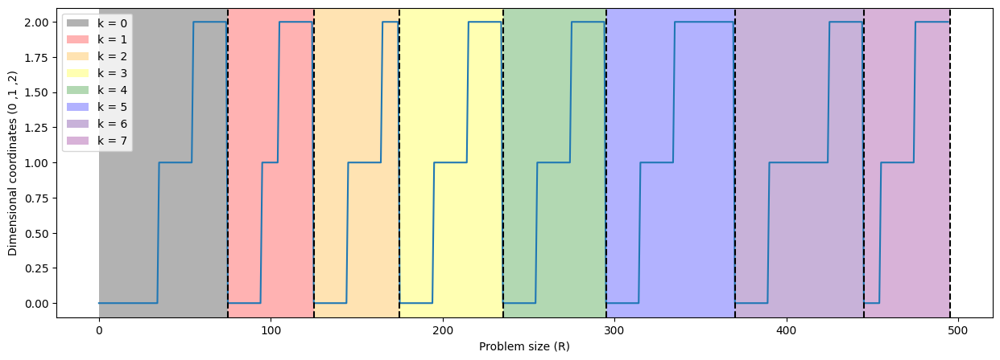

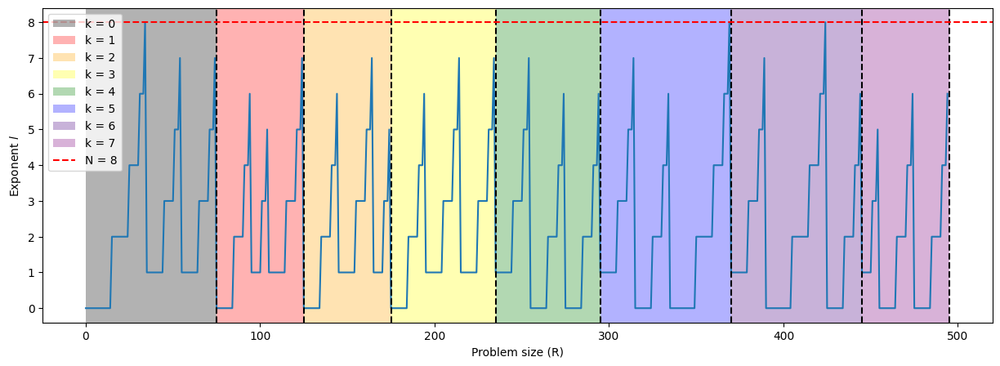

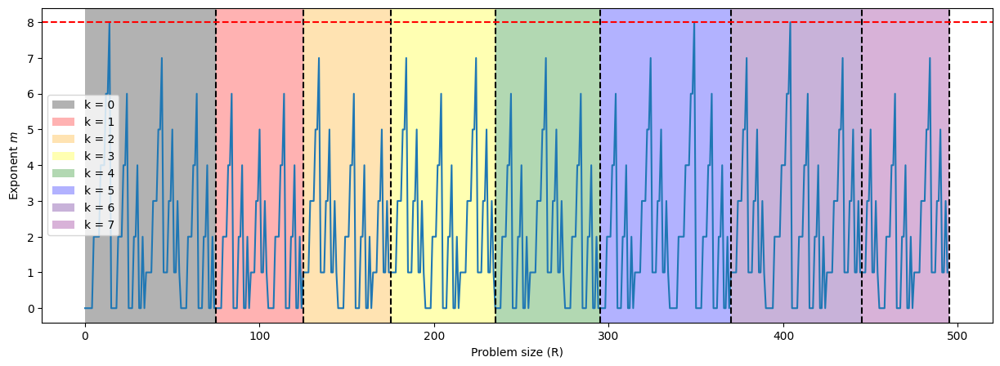

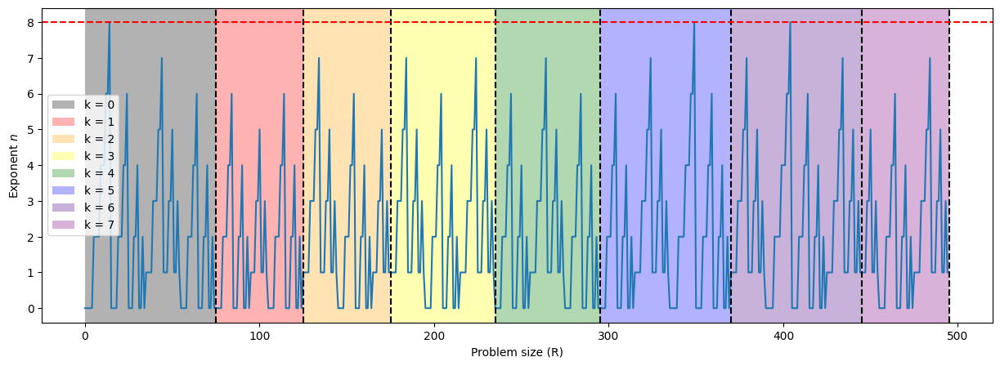

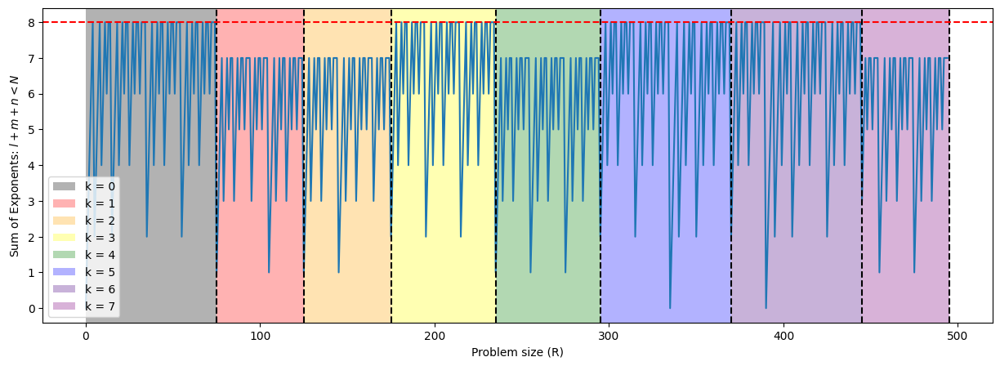

In [4]:
# Understand the tabs array through some plots
import matplotlib.pyplot as plt

block_colors = ['Black','Red', 'Orange', 'Yellow', 'Green', 'Blue', 'Indigo', 'Purple']

plt.figure('Dimensional coordinates', figsize = (15,5))
plt.plot(tabs[:,0])
irkcp = 0
irkc = 0
for k in range(0,len(irk)):
    irkcp = irkc
    irkc = irkc + irk[k]
    plt.axvline(irkc, c = 'k', linestyle ='--')
    plt.axvspan(irkcp ,irkc, facecolor = block_colors[k], alpha = 0.3, label = 'k = '+str(k)+'')
plt.ylabel('Dimensional coordinates (0 ,1 ,2)')
plt.xlabel('Problem size (R)')
plt.legend()

plt.figure('Exponent l', figsize = (15,5))
plt.plot(tabs[:,1])
irkcp = 0
irkc = 0
for k in range(0,len(irk)):
    irkcp = irkc
    irkc = irkc + irk[k]
    plt.axvline(irkc, c = 'k', linestyle ='--')
    plt.axvspan(irkcp ,irkc, facecolor = block_colors[k], alpha = 0.3, label = 'k = '+str(k)+'')
plt.axhline(d, c = 'r', linestyle ='--', label = 'N = '+str(d)+'')
plt.ylabel('Exponent $l$')
plt.xlabel('Problem size (R)')
plt.legend()

plt.figure('Exponent m', figsize = (15,5))
plt.plot(tabs[:,2])
irkcp = 0
irkc = 0
for k in range(0,len(irk)):
    irkcp = irkc
    irkc = irkc + irk[k]
    plt.axvline(irkc, c = 'k', linestyle ='--')
    plt.axvspan(irkcp ,irkc, facecolor = block_colors[k], alpha = 0.3, label = 'k = '+str(k)+'')
plt.axhline(d, c = 'r', linestyle ='--')
plt.ylabel('Exponent $m$')
plt.xlabel('Problem size (R)')
plt.legend()

plt.figure('Exponent n', figsize = (15,5))
plt.plot(tabs[:,2])
irkcp = 0
irkc = 0
for k in range(0,len(irk)):
    irkcp = irkc
    irkc = irkc + irk[k]
    plt.axvline(irkc, c = 'k', linestyle ='--')
    plt.axvspan(irkcp ,irkc, facecolor = block_colors[k], alpha = 0.3, label = 'k = '+str(k)+'')
plt.axhline(d, c = 'r', linestyle ='--')
plt.ylabel('Exponent $n$')
plt.xlabel('Problem size (R)')
plt.legend()

plt.figure('Sum of Exponents l, m , n', figsize = (15,5))
plt.plot(numpy.sum(tabs[:,1:],axis=1))
irkcp = 0
irkc = 0
for k in range(0,len(irk)):
    irkcp = irkc
    irkc = irkc + irk[k]
    plt.axvline(irkc, c = 'k', linestyle ='--')
    plt.axvspan(irkcp ,irkc, facecolor = block_colors[k], alpha = 0.3, label = 'k = '+str(k)+'')
plt.axhline(d, c = 'r', linestyle ='--')
plt.ylabel('Sum of Exponents: $l + m + n < N$')
plt.xlabel('Problem size (R)')
plt.legend()

In [5]:
def Phi(dimensions, tabs):
    '''
    Calculate the basis function \Phi_{\lambda}, where \lambda contains the indices l, m, n
    '''
    PHI = []
    #for vals in tabs:
    i, l, m, n = tabs
    PHI = dimensions[0]**l * dimensions[1]**m * dimensions[2]**n
    return PHI

# Choose a frequency to plot

In [6]:
# Put all the eigenvalues in a long single array
decimals = 10
EIGVALS = numpy.concatenate(eigvals)#/(2*numpy.pi)
# Identify where in this long array a desired frequency repeats
EIGVALS = numpy.round(EIGVALS, decimals = decimals) # Truncate the decimal values to identify the frequencies
# EIGVALS = EIGVALS.sort() # sort the eigenvalues if needed
wsort = numpy.round(wsort, decimals = decimals) # Truncate the decimal values to identify the frequencies
pos = numpy.where(EIGVALS == wsort[7])[0] # Choose a frequency to plot and find its indices!!!
print('Indices where wsort equals the frequency: ', pos)
print('Frequencies: ', 1e5*numpy.sqrt(EIGVALS[pos])/(2*numpy.pi))
# Find the eigenvectors for those eigenvalue positions

Indices where wsort equals the frequency:  [  1 371]
Frequencies:  [29025.26116801 29025.26116801]


In [7]:
wsort

array([-0.00000000e+00, -0.00000000e+00, -0.00000000e+00,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  2.13456573e+00,  3.32592161e+00,
        3.32592161e+00,  4.54026897e+00,  4.54026897e+00,  4.59124766e+00,
        4.59124766e+00,  4.94681810e+00,  5.92622497e+00,  5.92622497e+00,
        6.29286470e+00,  6.29286470e+00,  8.53854839e+00,  8.59172475e+00,
        8.59172475e+00,  9.87740629e+00,  9.91177874e+00,  9.91177874e+00,
        1.03669055e+01,  1.03669055e+01,  1.05122159e+01,  1.15257125e+01,
        1.15257125e+01,  1.15896070e+01,  1.15896070e+01,  1.20179063e+01,
        1.20179063e+01,  1.23576628e+01,  1.45335013e+01,  1.45335013e+01,
        1.46092387e+01,  1.46092387e+01,  1.60598457e+01,  1.60598457e+01,
        1.65887933e+01,  1.65887933e+01,  1.68277761e+01,  1.68277761e+01,
        1.79902342e+01,  1.79902342e+01,  1.82749460e+01,  1.92191713e+01,
        2.06156051e+01,  2.06156051e+01,  2.06374658e+01,  2.06374658e+01,
        2.11698873e+01,  

# Plot eigenvalues and eigenvectors

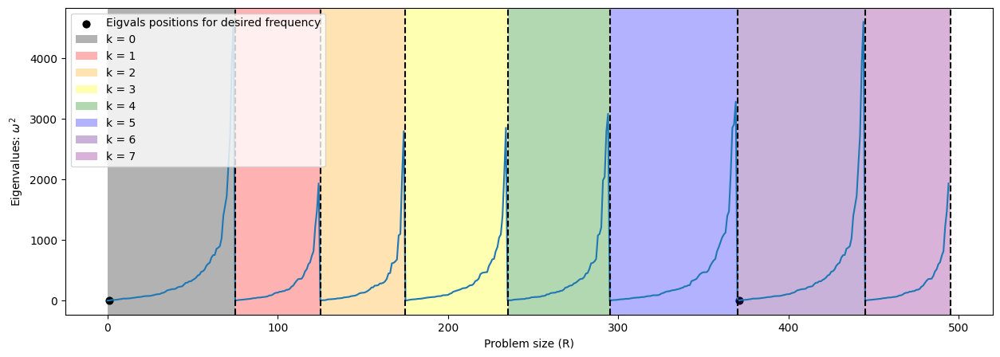

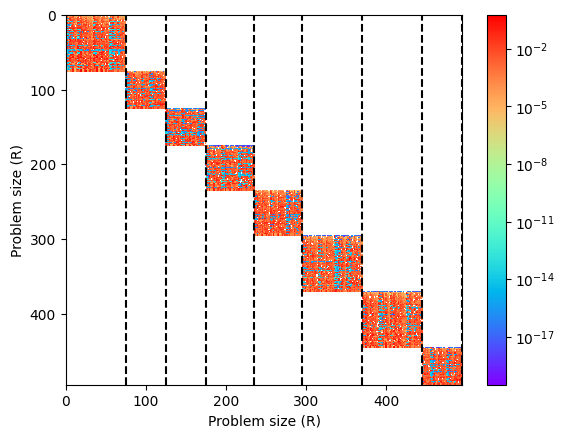

In [8]:
# EIGENVALUES
# Plot the eigenvalues per block
plt.figure('Sum of Exponents l, m , n', figsize = (15,5))
plt.plot(EIGVALS)
plt.scatter(pos, EIGVALS[pos], s = 40, c='k', label = 'Eigvals positions for desired frequency')
irkcp = 0
irkc = 0
irk_lims = []
for k in range(0,len(irk)):
    irkcp = irkc
    irkc = irkc + irk[k]
    irk_lims.append(irkc)
    plt.axvline(irkc, c = 'k', linestyle ='--')
    plt.axvspan(irkcp ,irkc, facecolor = block_colors[k], alpha = 0.3, label = 'k = '+str(k)+'')
plt.ylabel('Eigenvalues: $\omega^2$')
plt.xlabel('Problem size (R)')
plt.legend()

# EIGENVECTORS
# Each of the 8 blocks contains irk[k] eigenvectors
plt.figure('Eigenvectors')
plt.pcolor(z, cmap = 'rainbow', norm = 'log')
for val in irk_lims:
    plt.axvline(val, c = 'k', linestyle ='--')#, label = 'Block limits')
plt.xlabel('Problem size (R)')
plt.ylabel('Problem size (R)')
plt.gca().invert_yaxis()
plt.colorbar()
#plt.legend()

In [9]:
def u_i(z, location, pos):
    '''
    Calculates the displacement components for a location on or within the sample material
    z = matrix of eigenvectors.
    pos = index vector of positions where a desired eigenvalue (frequency) is stored
    Attention: if pos is a single value, put it in brackets within the function [pos]
    that way it makes it iterable in python.
    location = [X, Y, Z] position
    '''
    dx = 0
    dy = 0
    dz = 0
    for p in pos:
        j = 0
        for tab in tabs:
            i, l, m, n = tab
            if i == 0:
                dx = dx + z[p,j]*Phi(location, tab)
            elif i == 1:
                dy = dy + z[p,j]*Phi(location, tab)
            elif i == 2:
                dz = dz + z[p,j]*Phi(location, tab)
            # print(j, i, l, m, n)
            j+=1
    return numpy.array([dx, dy, dz])

# location = [dimension1*numpy.cos(numpy.pi/4), dimension2*numpy.cos(numpy.pi/4) , 0] # -dimension1*numpy.cos(numpy.pi/4),-dimension2*numpy.cos(numpy.pi/4)
# dx, dy, dz = u_i(z, location, [pos[1]]) # pos[2] is in k = 5 (Volume oscillates)

# du=numpy.array([dx,dy,dz])
# du_n = du/numpy.linalg.norm(du)
# print('Norm vector: ',du_n)

# Plot the outline of the equator

(-2.430931197969683,
 2.4320443427604608,
 -2.4317938659156315,
 2.4317938659156315)

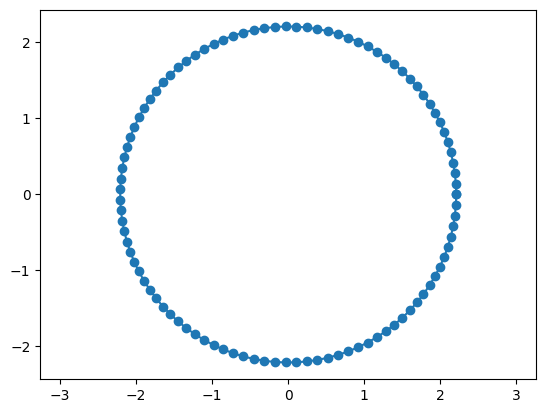

In [10]:
Radius = dimension1
theta = numpy.linspace(0, 2*numpy.pi, 100)
locations = numpy.c_[Radius*numpy.cos(theta), Radius*numpy.sin(theta), 2.5*numpy.ones(len(theta)) ]

plt.figure()
plt.plot(locations[:,0], locations[:,1])
plt.scatter(locations[:,0], locations[:,1])
plt.axis('equal')

# Plot the vectors for a particular frequency on the equator

The code in the next cell performs three steps:

1) Find where a particular frequency occurs in our sorted eigenvalues vector (`wsort`).
```python
pos = numpy.where(EIGVALS == wsort[11])[0] # Choose a frequency to plot and find its indices!!!
print('Indices where wsort equals the frequency: ', pos)
print('Frequencies: ', 1e5*numpy.sqrt(EIGVALS[pos])/(2*numpy.pi))
```

2) Calculate the displacements for one of those particular frequencies around the equator locations defined before
```python
DU = numpy.zeros((len(locations),2))
i = 0
for loc in locations:
    dx, dy, dz = u_i(z, [loc[0], loc[1], 0], [pos[4]]) # pos: use all positions, otherwise choose a particular one (e.g. [pos[3]])
    du=numpy.array([dx,dy,dz])
    du_n = du/numpy.linalg.norm(du)
    DU[i,0] = du_n[0]
    DU[i,1] = du_n[1]
    i+=1
```

3) Plot the displacement vectors
```python
plt.figure('Displacements')
plt.plot(locations[:,0], locations[:,1])
plt.scatter(locations[:,0], locations[:,1])
for i in range(0,len(locations)):
    plt.quiver(locations[i,0], locations[i,1], DU[i,0], DU[i,1])
plt.grid(True)
plt.axis('equal')
```

Indices where wsort equals the frequency:  [  1 371]
Frequencies:  [29025.26116801 29025.26116801]


(-2.430931197969683,
 2.4320443427604608,
 -2.4317938659156315,
 2.4317938659156315)

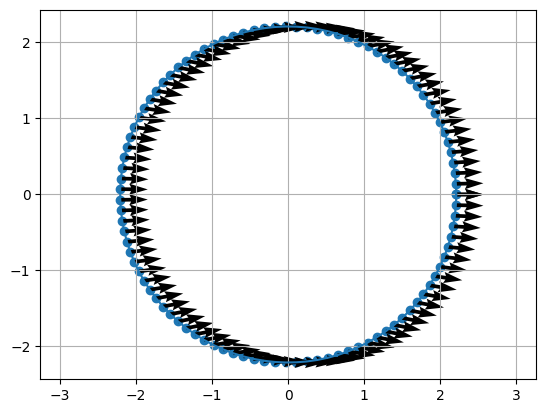

In [11]:
pos = numpy.where(EIGVALS == wsort[7])[0] # Choose a frequency to plot and find its indices!!!
print('Indices where wsort equals the frequency: ', pos)
print('Frequencies: ', 1e5*numpy.sqrt(EIGVALS[pos])/(2*numpy.pi))

DU = numpy.zeros((len(locations),2))
i = 0
for loc in locations:
    dx, dy, dz = u_i(z, [loc[0], loc[1], loc[2]], [pos[0]]) # pos: use all positions, otherwise choose a particular one (e.g. [pos[3]])
    du=numpy.array([dx,dy,dz])
    du_n = du/numpy.linalg.norm(du)
    DU[i,0] = du_n[0]
    DU[i,1] = du_n[1]
    i+=1

plt.figure('Displacements')
plt.plot(locations[:,0], locations[:,1])
plt.scatter(locations[:,0], locations[:,1])
for i in range(0,len(locations)):
    plt.quiver(locations[i,0], locations[i,1], DU[i,0], DU[i,1])
plt.grid(True)
plt.axis('equal')

# References

- Visscher, W. M., Migliori, A., Bell, T. M., & Reinert, R. A. (1991). On the normal modes of free vibration of inhomogeneous and anisotropic elastic objects. The Journal of the Acoustical Society of America, 90(4), 2154-2162.
- Migliori, A., Sarrao, J. L., Visscher, W. M., Bell, T. M., Lei, M., Fisk, Z., & Leisure, R. G. (1993). Resonant ultrasound spectroscopic techniques for measurement of the elastic moduli of solids. Physica B: Condensed Matter, 183(1-2), 1-24.
- de Rue, J. (1996). On the normal modes of freely vibrating elastic objects of various shapes (MSc thesis, University of Amsterdam).
- Zadler, B. J., Le Rousseau, J. H., Scales, J. A., & Smith, M. L. (2004). Resonant ultrasound spectroscopy: theory and application. Geophysical Journal International, 156(1), 154-169.

# Create many locations on the surface of the cylinder

In [12]:
z_locations = numpy.linspace(-dimension3, dimension3, 25)
theta = numpy.linspace(0, 2*numpy.pi, 100)
xy_locations = numpy.c_[Radius*numpy.cos(theta), Radius*numpy.sin(theta)]

In [13]:
locations = []
for i in range(0, len(xy_locations)):
    for j in range(0, len(z_locations)):
        locations.append([xy_locations[i][0], xy_locations[i][1], z_locations[j]])
locations = numpy.array(locations)

In [14]:
xs = locations[:,0]
ys = locations[:,1]
zs = locations[:,2]

In [15]:
#%matplotlib qt

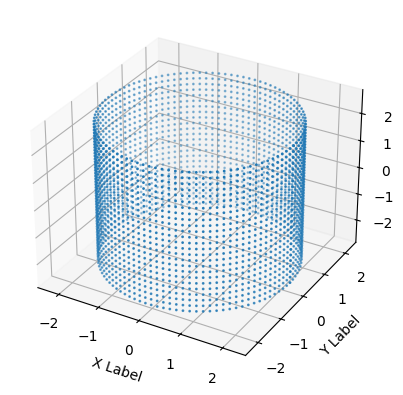

In [16]:
# Check the points are part of a cylinder
fig = plt.figure()
ax = fig.add_subplot(projection='3d')

m = 'o'
ax.scatter(xs, ys, zs, marker=m, s = 1)

ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

plt.show()

# Choose the frequency to plot and calculate the displacements

The `wsort` array below contains the sorted eigenvalues of the resonant frequencies from the minimum to the maximum from element 6 onwards.

In [17]:
%%time
pos = numpy.where(EIGVALS == wsort[30])[0] # Choose a frequency to plot and find its indices!!!
print('Indices where wsort equals the frequency: ', pos)
frequencies = 1e5*numpy.sqrt(EIGVALS[pos])/(2*numpy.pi)
print('Frequencies: ', frequencies)
resonant_frequency = frequencies[0]

DU = numpy.zeros((len(locations),3))
i = 0
for loc in locations:
    dx, dy, dz = u_i(z, [loc[0], loc[1], loc[2]], [pos[0]]) # pos: use all positions, otherwise choose a particular one (e.g. [pos[3]])
    du=numpy.array([dx,dy,dz])
    #du_n = du/numpy.linalg.norm(du)
    DU[i,0] = du[0]
    DU[i,1] = du[1]
    DU[i,2] = du[2]
    i+=1

DU = numpy.array(DU)

Indices where wsort equals the frequency:  [ 78 448]
Frequencies:  [54181.93187463 54181.93187463]
CPU times: user 4.58 s, sys: 8.32 ms, total: 4.59 s
Wall time: 4.61 s


# Plot the magnitude of displacement in the XY plane

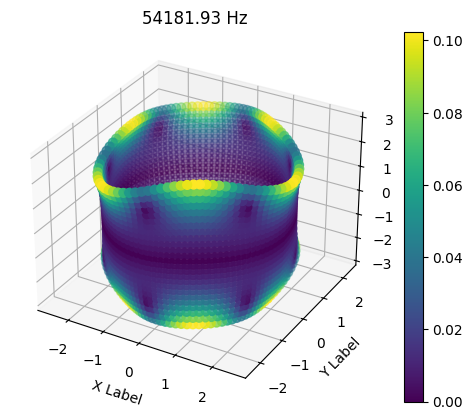

In [18]:
#%matplotlib qt
#%matplotlib inline
displacements = locations + 3*DU
xs = displacements[:,0]
ys = displacements[:,1]
zs = displacements[:,2]

fig = plt.figure()
ax = fig.add_subplot(projection='3d')

m = 'o'
p = ax.scatter(xs, ys, zs, marker=m, s = 40, c = numpy.sqrt(DU[:,0]**2 + DU[:,1]**2))

ax.set_title(f'{resonant_frequency:8.2f} Hz')
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

fig.colorbar(p)
plt.show()

In [19]:
import plotly.graph_objects as go
import numpy as np

fig = go.Figure(data=[go.Scatter3d(
    x=xs,
    y=ys,
    z=zs,
    mode='markers',
    marker=dict(
        size=12,
        color=numpy.sqrt(DU[:,0]**2 + DU[:,1]**2 + DU[:,2]**2),                # set color to an array/list of desired values
        colorscale='Viridis',   # choose a colorscale
        opacity=1.0,
        colorbar=dict(thickness=20)
    )
)])

# tight layout
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()

# Animate the movement

The displacements can be animated by assuming the resonant vibration is a complex exponential multiplied for each displacement amplitude at the locations on the surface of the shape.

In [20]:
import plotly.graph_objects as go
import numpy as np

# Assuming xs, ys, zs, resonant_frequency, and DU are defined from the previous code

time = np.linspace(0, 40e-3, 100)  # Time from 0 to 40 ms

frames = []
for t in time:
    complex_exp = np.exp(1j * resonant_frequency * 2 * np.pi * t)
    new_xs = locations[:,0] + 3*DU[:,0] * complex_exp.real
    new_ys = locations[:,1] + 3*DU[:,1] * complex_exp.real
    new_zs = locations[:,2] + 3*DU[:,2] * complex_exp.real

    frame = go.Frame(data=[go.Scatter3d(x=new_xs, y=new_ys, z=new_zs,
                                        mode='markers',
                                        marker=dict(
                                            size=5,
                                            color=np.sqrt(DU[:, 0]**2 + DU[:, 1]**2 + DU[:, 2]**2),
                                            colorscale='Viridis',
                                            opacity=1.0
                                        ))],
                     name=str(t))
    frames.append(frame)

fig = go.Figure(
    data=[go.Scatter3d(x=locations[:,0], y=locations[:,1], z=locations[:,2], mode='markers',
                       marker=dict(size=5, color=np.sqrt(DU[:, 0]**2 + DU[:, 1]**2 + DU[:, 2]**2),
                                   colorscale='Viridis', opacity=1.0))],
    frames=frames
)

fig.update_layout(
    title=f'{resonant_frequency:8.2f} Hz',
    updatemenus=[dict(
        type="buttons",
        buttons=[dict(label="Play",
                      method="animate",
                      args=[None, {"frame": {"duration": 20, "redraw": True},
                                   "transition": {"duration": 0},
                                   "fromcurrent": True,
                                   "mode": "immediate"
                                   }])])],

    )

scene = {
    # ...
    'aspectmode': 'cube',
}

fig.show()